In [6]:
import functools as fn
import datetime
import math

import pandas as pd
import numpy as np
import scipy.stats as scs
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC
import dask.dataframe as dd

from matplotlib import pyplot as plt
import plotly.graph_objects as go


In [7]:
import taq_data_cleaning

In [8]:
t = pd.read_csv('./query_trades_AAPL_20200106_born202210121745.csv',)
q = pd.read_csv('./query_quotes_AAPL_20200106_born202210121744.csv',)

c:\Users\E\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (24) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [9]:
q_v = taq_data_cleaning.clean_quotes(q)
pdts = fn.partial(taq_data_cleaning.ts_to_pdts, dte=datetime.datetime(2020,1,6))
q_v['pdts'] = q_v['Participant_Timestamp'].apply(pdts)
t_valid_LAQ_sec611 = taq_data_cleaning.valid_trades(t,q)
t_valid_LAQ_sec611['pdts'] = t_valid_LAQ_sec611['Participant_Timestamp'].apply(pdts)

In [11]:
fig_outliers = go.Figure(go.Scatter(x=t_valid_LAQ_sec611['pdts'].to_numpy(), y= t_valid_LAQ_sec611['Trade_Price'].to_numpy(), 
                        mode='markers', marker=dict(size=1,), name="Trade Price ($)"))
fig_outliers.add_trace(go.Scatter(x=t_valid_LAQ_sec611['pdts'].to_numpy(), y= t_valid_LAQ_sec611['LAQ_offer'].to_numpy(),
                        mode='markers', marker=dict(size=1 ), name="Last Best Offer Quote"))
fig_outliers.add_trace(go.Scatter(x=t_valid_LAQ_sec611['pdts'].to_numpy(),y= t_valid_LAQ_sec611['LAQ_bid'].to_numpy(),
                            mode='markers', marker=dict( size=1 ),  name="Last Best Bid Quote"))
fig_outliers.update_layout(title="Cleaned TAQ Data - Last Active Valid Quote and Trade Record",
                            xaxis_title="Time", yaxis_title="Last Best Bid Quote")

fig_outliers.show()

In [19]:
q_v['sip'] = q_v['Time'].apply(taq_data_cleaning.ts_to_secs)
def strtime_to_sec(f):
    f = f.split()[1].split(':')
    return float(f[0])*3600.0 + float(f[1])*60.0+float(f[1])
t_valid_LAQ_sec611['sip'] = t_valid_LAQ_sec611['Time'].apply(strtime_to_sec)

In [14]:
ex = 'Q'
time_range = 0.1 ## second interval
ptnear = []
sipnear = []
for i in range(len(t_v)):
    t0_pt = t_v['pt_secs'].iloc[i]
    t0_sip = t_v['sip'].iloc[i]
    q0s = q_v[np.logical_and(q_v['pt_secs'] >= t0_pt - time_range, q_v['pt_secs'] <= t0_pt + time_range)] 
    q0s_sip = q_v[np.logical_and(q_v['sip'] >= t0_sip - time_range, q_v['sip'] <= t0_sip + time_range)] 
    ptnear += list(q0s['pt_secs'] - t0_pt)
    sipnear += list(q0s_sip['sip'] - t0_sip)



Text(0, 0.5, 'bin counts')

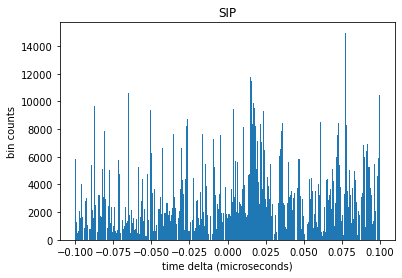

In [15]:
plt.hist(sipnear, bins =300)
plt.title('SIP')
plt.xlabel('time delta (microseconds)')
plt.ylabel('bin counts')

Text(0, 0.5, 'bin counts')

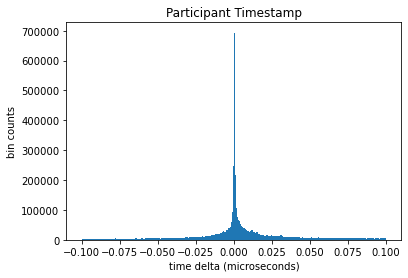

In [16]:
plt.hist(ptnear, bins =300);
plt.title('Participant Timestamp')
plt.xlabel('time delta (microseconds)')
plt.ylabel('bin counts')

In [18]:
q_v = taq_data_cleaning.clean_quotes(q)
t_valid_LAQ_sec611 = taq_data_cleaning.valid_trades(t,q)
flipq0 = np.cumsum(q_v['Bid_Price'] > q_v['Offer_Price'] )
flipq_clean = np.cumsum(t_valid_LAQ_sec611['LAQ_bid'] > t_valid_LAQ_sec611['LAQ_offer'])

In [20]:
fig_flipped = go.Figure()
fig_flipped.add_trace(go.Scatter(x=t_valid_LAQ_sec611['pt_secs'].to_numpy(), 
                                y=flipq_clean, name="Cleaned, Valid Quotes" ))
fig_flipped.add_trace(go.Scatter(x=q_v['pt_secs'].to_numpy(), 
                                y=flipq0, name="Raw Quote Data  "))
fig_flipped.update_layout(title="Cumulative Count of Boxed Quotes",
                            xaxis_title="Time",
                            yaxis_title="Count")